<a href="https://colab.research.google.com/github/ImanLiao/COMP3029-ComputerVision/blob/main/COMP3029_Lab02.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

This notebook documents the lab-2 excercise for the module COMP3029 (Computer Vision) at the University of Nottingham Malaysia, prepared by Dr. Iman Yi Liao.

## Main Objectives

The lab session aims to provide students experience on using Python and its libraries for reading, writing, and manipulating images in Google Colab environment.

## Main Tasks

1. Access oil palm seed images dataset
2. Read and write sample oil palm seed images
3. Perform image segmentation tasks
4. Perform feature extraction tasks

# Installation of libraries

**NumPy** is a library for the Python programming language that (among other things) provides support for large, multi-dimensional arrays.

Going hand-in-hand with NumPy, we also have **SciPy**. SciPy adds further support for scientific and technical computing. 

The **h5py** library is the de-facto standard in Python to store large numerical datasets. It provides support for NumPy arrays. So, if you have a large dataset represented as a NumPy array, and it won’t fit into memory, or if you want efficient, persistent storage of NumPy arrays, then h5py is the way to go. 

Simply put, **matplotlib** is a plotting library. If you’ve ever used MATLAB before, you’ll probably feel very comfortable in the matplotlib environment.

PIL and **Pillow** does simple image manipulations, such as resizing, rotation, etc.

If NumPy’s main goal is large, efficient, multi-dimensional array representations, then, by far, the main goal of **OpenCV** is real-time image processing. This library has been around since 1999, but it wasn’t until the 2.0 release in 2009 did we see the incredible NumPy support.

The algorithms included in **scikit-image** follow closer to the state-of-the-art in computer vision. New algorithms right from academic papers can be found in scikit-image, but in order to (effectively) use these algorithms, you need to have developed some rigor and understanding in the computer vision field.

**Scikit-learn** isn’t an image processing or computer vision library — it’s a machine learning library. That said, you can’t have advanced computer vision techniques without some sort of machine learning, whether it be clustering, vector quantization, classification models, etc. Scikit-learn also includes a handful of image feature extraction functions as well.

**Pandas** is a fast, powerful, flexible and easy to use open source data analysis and manipulation tool.

In [ ]:
!pip install torch torchvision

In [ ]:
!pip install numpy

In [ ]:
!pip install scipy

In [ ]:
!pip install h5py

In [ ]:
!pip install matplotlib

In [ ]:
!pip install pillow

In [ ]:
!pip install scikit-learn

In [ ]:
!pip install scikit-image

In [ ]:
!pip install pandas

In [2]:
!apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python
import cv2

# Mont Google Drive

In [3]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [4]:
!ls "/content/drive/My Drive/"

 AAR		    foo.txt		     'Tan JoiSan'
'Colab Notebooks'  'Letter of Dr. Iman.PDF'  'USF 3D Face Database'
 CRM		   'MOSTI ICF 2020'
 Custlr		    Projects


In [5]:
%cd /content/drive/My Drive/AAR

/content/drive/My Drive/AAR


In [6]:
!ls "/content/drive/My Drive/AAR/seed/GoodSeed"

SAM_7379.JPG  SAM_7405.JPG  SAM_7428.JPG  SAM_7450.JPG	SAM_7474.JPG
SAM_7384.JPG  SAM_7406.JPG  SAM_7429.JPG  SAM_7451.JPG	SAM_7475.JPG
SAM_7385.JPG  SAM_7407.JPG  SAM_7430.JPG  SAM_7452.JPG	SAM_7476.JPG
SAM_7386.JPG  SAM_7408.JPG  SAM_7431.JPG  SAM_7453.JPG	SAM_7477.JPG
SAM_7387.JPG  SAM_7409.JPG  SAM_7432.JPG  SAM_7454.JPG	SAM_7478.JPG
SAM_7388.JPG  SAM_7410.JPG  SAM_7433.JPG  SAM_7455.JPG	SAM_7479.JPG
SAM_7389.JPG  SAM_7411.JPG  SAM_7434.JPG  SAM_7456.JPG	SAM_7480.JPG
SAM_7390.JPG  SAM_7412.JPG  SAM_7435.JPG  SAM_7457.JPG	SAM_7481.JPG
SAM_7391.JPG  SAM_7413.JPG  SAM_7436.JPG  SAM_7458.JPG	SAM_7482.JPG
SAM_7392.JPG  SAM_7414.JPG  SAM_7437.JPG  SAM_7459.JPG	SAM_7483.JPG
SAM_7393.JPG  SAM_7415.JPG  SAM_7438.JPG  SAM_7460.JPG	SAM_7484.JPG
SAM_7394.JPG  SAM_7416.JPG  SAM_7439.JPG  SAM_7461.JPG	SAM_7485.JPG
SAM_7395.JPG  SAM_7417.JPG  SAM_7440.JPG  SAM_7462.JPG	SAM_7486.JPG
SAM_7396.JPG  SAM_7418.JPG  SAM_7441.JPG  SAM_7463.JPG	SAM_7487.JPG
SAM_7397.JPG  SAM_7419.JPG  SAM_7442.JPG  SAM_74

# Access oil palm seed images

## Access zipped image data on Google drive

In [ ]:
# importing required modules 
from zipfile import ZipFile 

# specifying the zip file name 
file_name = "seed.zip"

# opening the zip file in READ mode 
with ZipFile(file_name, 'r') as zip: 
	# printing all the contents of the zip file 
	zip.printdir() 

	# extracting all the files 
	print('Extracting all the files now...') 
	zip.extractall() 
	print('Done!') 


File Name                                             Modified             Size
seed/                                          2021-01-29 17:01:10            0
seed/BadSeed/                                  2021-01-21 02:09:24            0
seed/BadSeed/SAM_7496.JPG                      2016-03-31 22:54:22      4955379
seed/BadSeed/SAM_7497.JPG                      2016-03-31 22:54:26      4936300
seed/BadSeed/SAM_7498.JPG                      2016-03-31 22:56:06      5818738
seed/BadSeed/SAM_7499.JPG                      2016-03-31 22:57:36      5754657
seed/BadSeed/SAM_7500.JPG                      2016-03-31 22:59:02      5738000
seed/BadSeed/SAM_7501.JPG                      2016-03-31 23:00:20      5853452
seed/BadSeed/SAM_7503.JPG                      2016-03-31 23:04:04      5473881
seed/BadSeed/SAM_7504.JPG                      2016-03-31 23:05:54      5861499
seed/BadSeed/SAM_7505.JPG                      2016-03-31 23:07:08      4524169
seed/BadSeed/SAM_7506.JPG               

If you are given a url to access the dataset in a zipped file, you may use the following code instead (to be done).

## Read a sample image using opencv or pillow

In [7]:
from PIL import Image
image = Image.open("/content/drive/My Drive/AAR/seed/GoodSeed/SAM_7379.JPG")
image.show()

(3648, 5472, 3)


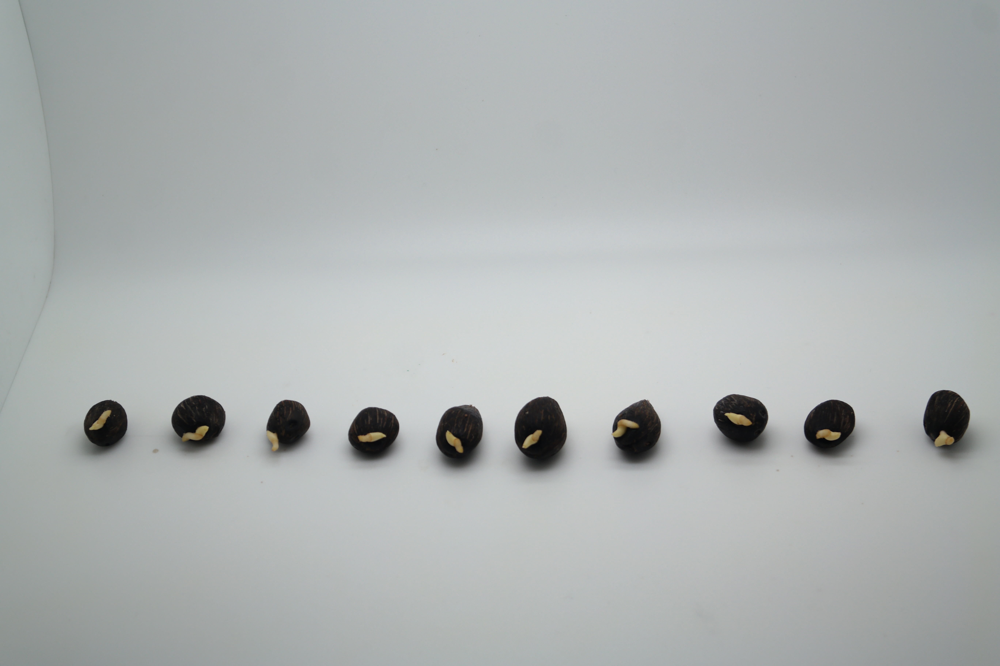

In [13]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

path = '/content/drive/My Drive/AAR/seed/GoodSeed/SAM_7379.JPG'

# Using cv2.imread() method
image = cv2.imread(path)

print(image.shape)

# Displaying the image
# cv2.imshow('image', image) # cv2.imshow() is disabled in Colab, because it causes Jupyter sessions to crash

cv2_imshow(image)


## Manipulate the image and save the changes

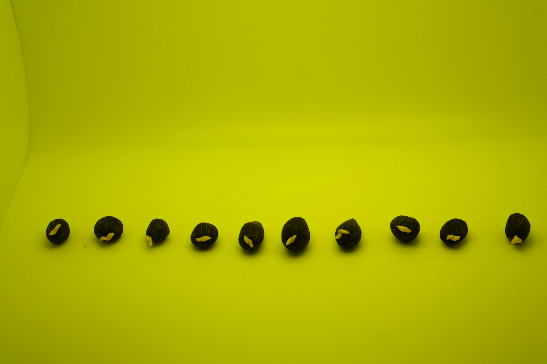

True

In [11]:
# Change blue channel to 0 and save it as a new image
img_nobluechannel = image.copy()  # make a copy of the original image
# img_nobluechannel = image # not using the copy, see the difference

img_nobluechannel[:,:,0] = 0  # OpenCV reads colour image to BGR channel order
#cv2_imshow(image)

scaling_factor = 0.10

height = int(image.shape[0] * scaling_factor)
width = int(image.shape[1] * scaling_factor)

img_resized = cv2.resize(img_nobluechannel, (width, height))
cv2_imshow(img_resized)

cv2.imwrite('/content/drive/My Drive/AAR/seed/no_blue_channel.jpg',img_resized)

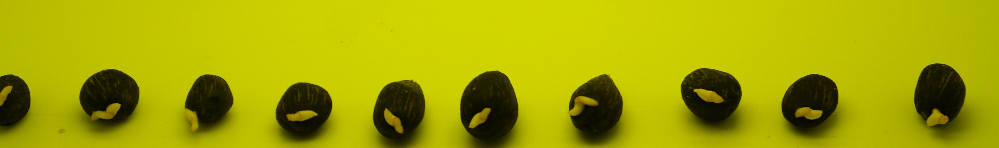

True

In [12]:
# You can also crop the original image
y = int(image.shape[0]/2)
x = int(image.shape[1]/10)
h = int(image.shape[0]/10*2)
w = int(image.shape[1]/10*9)

img_cropped = image[y:y+h, x:x+w]

cv2_imshow(img_cropped)

cv2.imwrite('/content/drive/My Drive/AAR/seed/cropped.jpg', img_cropped)

# Image Segmentation

## Use edge detection tools

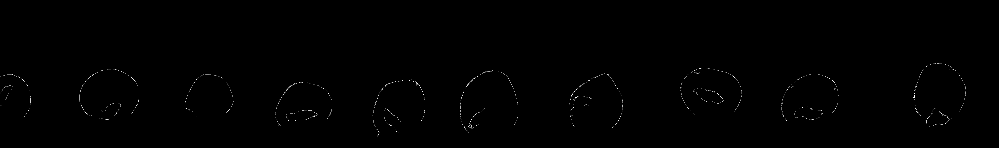

In [ ]:
# Convert the cropped image to grayscale
img_gray = cv2.cvtColor(img_cropped, cv2.COLOR_BGR2GRAY)

img_edged = cv2.Canny(img_gray, 20, 200)
cv2_imshow(img_edged)

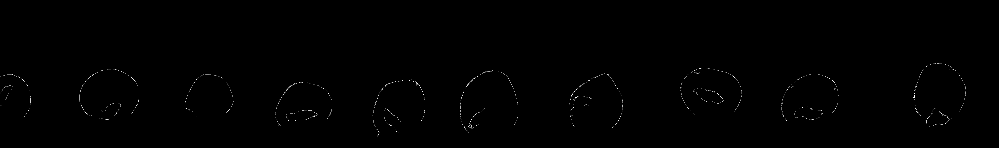

Numbers of contours found=401


In [ ]:
# Copy the image edge image before using contour function to find the contours
img_edged_copy = img_edged.copy()

contours, hierarchy = cv2.findContours(img_edged_copy, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

cv2_imshow(img_edged_copy)
# print(contours)
print('Numbers of contours found=' + str(len(contours)))

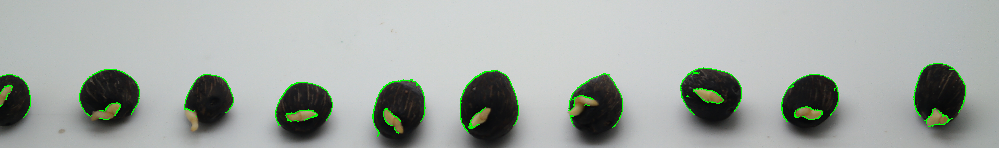

In [ ]:
# Draw contours over the edged image
cv2.drawContours(img_cropped,contours, -1, (0,255,0), 3)
cv2_imshow(img_cropped)

## Segment image in colour space

(3589596, 3)
(3589596, 1)
(2, 3)


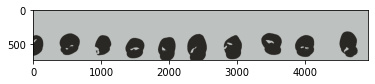

In [ ]:
# We work with cropped image
# conver the image from BGR to RGB
img_cropped = cv2.cvtColor(img_cropped, cv2.COLOR_BGR2RGB)

# reshape the image to a 2D array of pixels and 3 color values (RGB)
pixel_values = img_cropped.reshape((-1, 3))

# convert to float
pixel_values = np.float32(pixel_values)
print(pixel_values.shape)

# define stopping criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

# number of clusters (K)
k = 2 # as we want only to differentiate the seeds from the background, hoping to merge the sprouts into the foreground
_, labels, (centers) = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
print(labels.shape)

# convert back to 8 bit values
centers = np.uint8(centers)
print(centers.shape)

# flatten the labels array
labels = labels.flatten()

# convert all pixels to the color of the centroids
segmented_image = centers[labels]

# reshape back to the original image dimension
segmented_image = segmented_image.reshape(img_cropped.shape)

# show the image
import matplotlib.pyplot as plt
plt.imshow(segmented_image)
plt.show()

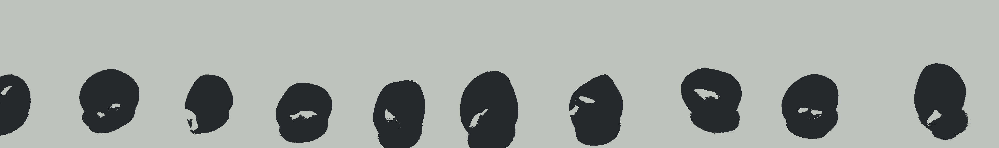

In [ ]:
cv2_imshow(segmented_image)

In [ ]:
print(labels.shape)

(3589596,)


In [ ]:
a = np.array([[1,2,3],[4,5,6]])
b = np.array([0, 1,1,1,0,0])
c = a[b]
d = c.reshape((2,3,-1))

#print(c)
print(d)

[[[1 2 3]
  [4 5 6]
  [4 5 6]]

 [[4 5 6]
  [1 2 3]
  [1 2 3]]]


In [ ]:
results = np.where(d == 4)
#print(type(results))
#print(results)
listofpoints = list(zip(results[0], results[1]))
print(listofpoints[0][1])

1


In [ ]:
print(centers)

[[189 193 191]
 [ 42  40  37]]


In [ ]:
from pandas import DataFrame
from sklearn.cluster import KMeans

df = DataFrame(listofpoints, columns = ['y', 'x'])
print(df)

   y  x
0  0  1
1  0  2
2  1  0


## Segment the seeds spatially

[[ 493.06060059 3513.1652238 ]
 [ 564.08729894 1971.2982352 ]
 [ 494.90678097  536.04646195]
 [ 495.57529975 4640.58954782]
 [ 549.762228   2944.11169092]
 [ 555.19401309 1497.10315067]
 [ 546.05277896 2414.89933969]
 [ 524.4048634  3997.93802031]
 [ 508.09898006 1032.3436658 ]
 [ 511.32565973   66.65733215]]


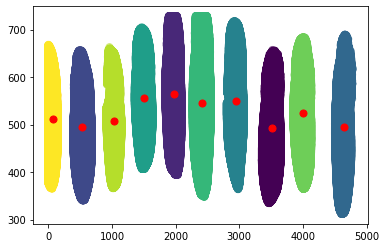

In [ ]:
from pandas import DataFrame  # we need to use dataframe to organise our list of coordinates
from sklearn.cluster import KMeans

# Extract the coordinates of the pixels that represent the foreground, i.e., oil palm seeds
# Based on the inspection we've done in the above, that pxiel value should be [42, 40, 37]

results = np.where(segmented_image == 42) # we only need to use value 42 since it's unique for the array [42, 40, 37], one can use 40 or 37 instead as well
# zip the coordinates together
foreground_points = list(zip(results[0], results[1]))

# convert to the dataframe 
df = DataFrame(foreground_points, columns=['y','x'])

spatial_kmeans = KMeans(n_clusters=10).fit(df)  # as there are 10 seeds in an image
centroids = spatial_kmeans.cluster_centers_
print(centroids)

plt.scatter(df['x'], df['y'], c= spatial_kmeans.labels_.astype(float), s=50, alpha=0.5)
plt.scatter(centroids[:, 1], centroids[:, 0], c='red', s=50)
plt.show()

# Image Feature Extraction with scikit-image

For more information, check the details at https://scikit-image.org/docs/dev/api/skimage.feature.html 

## Shape features (HOG)

(729, 4924, 3)


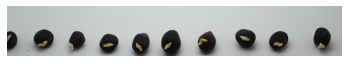

In [ ]:
#importing required libraries
from skimage.io import imread
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure
import matplotlib.pyplot as plt

# reading the image
img = imread('/content/drive/My Drive/AAR/seed/cropped.jpg')
plt.axis("off")
plt.imshow(img)
print(img.shape)

(256, 2048, 3)


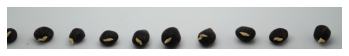

In [ ]:
# resizing image
resized_img = resize(img, (64*4, 512*4))
plt.axis("off")
plt.imshow(resized_img)
print(resized_img.shape)

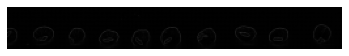

In [ ]:
#creating hog features
fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(8, 8),
                	cells_per_block=(2, 2), visualize=True, multichannel=True)
plt.axis("off")
plt.imshow(hog_image, cmap="gray")

In [ ]:
print(fd)
print(fd.shape)

[0.23630854 0.23630854 0.20142174 ... 0.19329045 0.04719318 0.05974393]
(284580,)


## Texture features (LBP)

In [ ]:
from skimage.io import imread
from skimage.transform import rotate
from skimage.feature import local_binary_pattern
#from skimage import data
from skimage.color import label2rgb
from skimage.color import rgb2gray

# settings for LBP
radius = 3
n_points = 8 * radius


def overlay_labels(image, lbp, labels):
    mask = np.logical_or.reduce([lbp == each for each in labels])
    return label2rgb(mask, image=image, bg_label=0, alpha=0.5)


def highlight_bars(bars, indexes):
    for i in indexes:
        bars[i].set_facecolor('r')


img = imread('/content/drive/My Drive/AAR/seed/cropped.jpg')
img = rgb2gray(img)
lbp = local_binary_pattern(img, n_points, radius)


def hist(ax, lbp):
    n_bins = int(lbp.max() + 1)
    return ax.hist(lbp.ravel(), density=True, bins=n_bins, range=(0, n_bins),
                   facecolor='0.5')


# plot histograms of LBP of textures
fig, (ax_img, ax_hist) = plt.subplots(nrows=2, ncols=3, figsize=(9, 6))
plt.gray()

titles = ('edge', 'flat', 'corner')
w = width = radius - 1
edge_labels = range(n_points // 2 - w, n_points // 2 + w + 1)
flat_labels = list(range(0, w + 1)) + list(range(n_points - w, n_points + 2))
i_14 = n_points // 4            # 1/4th of the histogram
i_34 = 3 * (n_points // 4)      # 3/4th of the histogram
corner_labels = (list(range(i_14 - w, i_14 + w + 1)) +
                 list(range(i_34 - w, i_34 + w + 1)))

label_sets = (edge_labels, flat_labels, corner_labels)

for ax, labels in zip(ax_img, label_sets):
    ax.imshow(overlay_labels(img, lbp, labels))

for ax, labels, name in zip(ax_hist, label_sets, titles):
    counts, _, bars = hist(ax, lbp)
    highlight_bars(bars, labels)
    ax.set_ylim(top=np.max(counts[:-1]))
    ax.set_xlim(right=n_points + 2)
    ax.set_title(name)

ax_hist[0].set_ylabel('Percentage')
for ax in ax_img:
    ax.axis('off')

## Point features (SIFT) with OpenCV

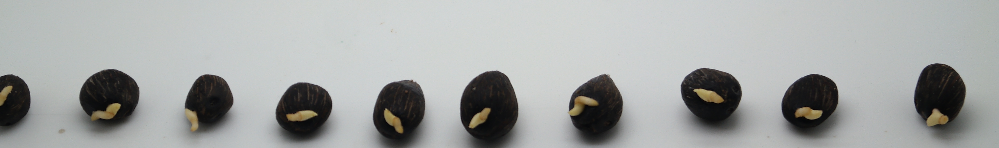

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

path = '/content/drive/My Drive/AAR/seed/cropped.jpg'
img_cropped = cv2.imread(path)
cv2_imshow(img_cropped)

In [ ]:
# convert to greyscale
img_gray = cv2.cvtColor(img_cropped, cv2.COLOR_BGR2GRAY)

In [ ]:
# create SIFT feature extractor
sift = cv2.xfeatures2d.SIFT_create()

In [ ]:
# detect features from the image
keypoints, descriptors = sift.detectAndCompute(img_gray, None)

In [ ]:
# draw the detected key points
sift_image = cv2.drawKeypoints(img_gray, keypoints, img_cropped)
# show the image
cv2_imshow(sift_image)
# save the image
cv2.imwrite("/content/drive/My Drive/AAR/seed/cropped_sift.jpg", sift_image)

Unfortunately the SIFT function in OpenCV is disabled for patent issue. There are, however, quite a number of SIFT implementation in Python. Here is one example of complete implementation of SIFT step by step https://medium.com/@russmislam/implementing-sift-in-python-a-complete-guide-part-1-306a99b50aa5